In [1]:
import sys
sys.path.append('.')

from bertopic.representation import KeyBERTInspired, VisualRepresentation
from bertopic.backend import MultiModalBackend
from bertopic import BERTopic
from PIL import Image
import os
import base64
from io import BytesIO
from IPython.display import HTML
from pathlib import Path
from torchvision import transforms
import torch
import pandas as pd
import pickle
# sys.path.append(str(Path(os.path.abspath(__file__)).parent.parent.parent))

# from src.utils import preprocessing

# import thumbnails

# from experiments.config import global_config



/Users/edith/git/SurfaceAI/classification_models/.venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Image embedding model
embedding_model = MultiModalBackend('clip-ViT-B-32', batch_size=32)

# # Image to text representation model
# representation_model = {
#     "Visual_Aspect": VisualRepresentation(image_to_text_model="nlpconnect/vit-gpt2-image-captioning")
# }

In [3]:
root_data = str(Path().resolve() / ".." / "data" / "training")
root_embeddings = str(Path().resolve() / ".." / "embeddings")

In [27]:
# # images
# root_data = str(Path().resolve() / ".." / ".." / "data" / "training")

# # images_path = os.path.join(root_data, 'V9/annotated/asphalt/bad')
# # images_path = os.path.join(root_data, 'seg_analysis/original/not_recognizable/multi/streets')
# images_path = os.path.join(root_data, 'V11/scene_cropped')
# images = []
# for root, _, fnames in sorted(os.walk(images_path, followlinks=True)):
#     for fname in sorted(fnames):
#         path = os.path.join(root, fname)
#         if fname.endswith((".jpg", ".jpeg", ".png")):
#             images.append(path)

# print(images[:5])

[]


In [4]:
# partial_labels = {'115613061245645': 'bikelane on sidewalk',
#                   '147530060597553': 'biklane on street',
#                   '152436594516951': 'bikelane on sidewalk',
#                   '161779362788691': 'bikelane on sidewalk',
#                   '314600876906279': 'biklane on street',
#                   '324264732453909': 'bikelane on sidewalk',
#                   '332779451733060': 'bikelane on sidewalk',
#                   '371383354168821': 'biklane on street',
#                   '406638231063174': 'bikelane on sidewalk',
#                   '476023756839183': 'bikelane on sidewalk',
#                   '485652966084685': 'bikelane on sidewalk',
#                   '527494424951466': 'biklane on street',
#                   '586506369409581': 'biklane on street',
#                   '645723314281364': 'biklane on street',
#                   }
# labels_categories = ['bikelane on sidewalk', 'biklane on street']
# def labels_index(label):
#     class_to_idx = {labels_categories[i]: i for i in range(len(labels_categories))}
#     return -1 if label not in class_to_idx.keys() else class_to_idx[label]

In [5]:
# # for guided topic modeling only
# seed_topic_list = [["bikelane on road"],
#                    ["bikelane on sidewalk"],
#                    ["driving"]]
# # for zero-shot modeling only
# zeroshot_topic_list = ["bikelane on road", "bikelane on sidewalk"]
# # for semi-supervised modeling only
# ids = [os.path.splitext(os.path.split(path)[-1])[0] for path in images]
# labels = [partial_labels.get(id, 'no label') for id in ids]
# y = [labels_index(label) for label in labels]


In [6]:
# # transform images
# images = [Image.open(img) for img in images]
# # lower half
# # images = [transforms.functional.crop(img, 0.5*img.size[1], 0, 0.5*img.size[1], img.size[0]) for img in images]

# images[0]

IndexError: list index out of range

In [ ]:
# # standard
# topic_model = BERTopic(embedding_model=embedding_model,
#                        representation_model=representation_model,
#                        min_topic_size=5)
# topics, probs = topic_model.fit_transform(documents=None, images=images)
# # # guided topic modeling
# # topic_model = BERTopic(embedding_model=embedding_model,
# #                        representation_model=representation_model,
# #                        min_topic_size=5,
# #                        seed_topic_list=seed_topic_list)
# # topics, probs = topic_model.fit_transform(documents=None, images=images)
# # # zero-shot topic modeling
# # topic_model = BERTopic(embedding_model=embedding_model,
# #                        representation_model=representation_model,
# #                     #    min_topic_size=5,
# #                        zeroshot_topic_list=zeroshot_topic_list,
# #                        zeroshot_min_similarity=0.7,)
# # topics, probs = topic_model.fit_transform(documents=None, images=images)
# # # semi-supervised topic modeling
# # topic_model = BERTopic(embedding_model=embedding_model,
# #                        representation_model=representation_model,
# #                        min_topic_size=5)
# # topics, probs = topic_model.fit_transform(documents=None,
# #                                           images=images,
# #                                           y=y)

# print(topics)
# print(probs)

In [ ]:
# print([id for i, id in enumerate(ids) if labels[i] != 'no label'])
# print([labels[i] for i, _ in enumerate(ids) if labels[i] != 'no label'])
# print([topic for i, topic in enumerate(topics) if labels[i] != 'no label'])

In [4]:
def image_base64(im):
    if isinstance(im, str):
        # im = get_thumbnail(im)
        print("is string")
    with BytesIO() as buffer:
        im.save(buffer, 'jpeg')
        return base64.b64encode(buffer.getvalue()).decode()


def image_formatter(im):
    return f'<img src="data:image/jpeg;base64,{image_base64(im)}">'

In [6]:
# topic_model.get_topic_info()

NameError: name 'topic_model' is not defined

In [ ]:
# df = topic_model.get_topic_info().drop("Representative_Docs", axis=1).drop("Name", axis=1)

# # Visualize the images
# HTML(df.to_html(formatters={'Visual_Aspect': image_formatter}, escape=False))

In [ ]:
# topic_model.visualize_topics()

In [ ]:
# df["Visual_Aspect"][0].show()

In [ ]:
# topic_model.get_topic(-1)

In [ ]:
# topic_model.get_params()

In [ ]:
# topic_model.topic_embeddings_.shape

In [ ]:
# topic_model.visualize_heatmap()

In [18]:
model_root = str(Path().resolve() / ".." / "trained_models")

# # V9/annotated
# model_name = "bertopic-20240507_132231"
# # V11/scene_cropped
# model_name = "bertopic-20240508_103554"
# V11/annotated clip embeddings (scene_cropped)
# model_name = "bertopic-20240508_104513"
# V11/annotated clip embeddings (scene_cropped), cluster_selection = 'leaf'
# model_name = "bertopic-20240508_104513"
# V11/annotated clip embeddings (scene_cropped), cluster_selection = 'leaf', nr_topics = 'auto'
# model_name = "bertopic-20240508_135032"
# V11/annotated dino embeddings (scene_cropped), cluster_selection = 'eom'
model_name = "bertopic-20240513_172254"
# V11/annotated dino embeddings (scene_cropped), cluster_selection = 'leaf'
model_name = "bertopic-20240513_172638"
# V11/annotated effnet features embeddings (scene_cropped), cluster_selection = 'eom'
# model_name = "bertopic-20240515_123441"
# V11/annotated effnet features embeddings (scene_cropped), cluster_selection = 'leaf'
# model_name = "bertopic-20240515_123656"
# V11/annotated effnet layer 5 embeddings (scene_cropped), cluster_selection = 'eom'
# model_name = "bertopic-20240516_110436"
# V11/annotated effnet layer 5 embeddings (scene_cropped), cluster_selection = 'leaf'
# model_name = "bertopic-20240516_110729"
# V11/annotated effnet_v2_s features embeddings (scene_cropped), cluster_selection = 'eom'
# model_name = "bertopic-20240516_111333"
# V11/annotated effnet_v2_s features embeddings (scene_cropped), cluster_selection = 'leaf'
# model_name = "bertopic-20240516_111745"

# V11/annotated clip embeddings (scene_cropped), cluster_selection = 'eom', semi-supervised
# model_name = "bertopic-20240515_213258"
# V11/annotated clip embeddings (scene_cropped), cluster_selection = 'leaf', semi-supervised
model_name = "bertopic-20240515_212631"
# V11/annotated effnet features embeddings (scene_cropped), cluster_selection = 'eom', semi-supervised
# model_name = "bertopic-20240516_095915"
# V11/annotated effnet features embeddings (scene_cropped), cluster_selection = 'leaf', semi-supervised
# model_name = "bertopic-20240516_100116"
# V11/annotated effnet layer 5 embeddings (scene_cropped), cluster_selection = 'eom', semi-supervised
# model_name = "bertopic-20240516_112504"
# V11/annotated effnet layer 5 embeddings (scene_cropped), cluster_selection = 'leaf', semi-supervised
# model_name = "bertopic-20240516_113047"
# V11/annotated effnet_v2_s features embeddings (scene_cropped), cluster_selection = 'eom', semi-supervised
# model_name = "bertopic-20240516_113839"
# V11/annotated effnet_v2_s features embeddings (scene_cropped), cluster_selection = 'leaf', semi-supervised
# model_name = "bertopic-20240516_114224"

# V11/annotated dino embeddings (scene_cropped), cluster = KMeans, cluster_size = 50
# model_name = 'bertopic-20240607_150341'
# V11/annotated dino embeddings (scene_cropped), cluster = KMeans, cluster_size = 100
# model_name = 'bertopic-20240607_154038'


model_path = os.path.join(model_root, model_name)
print(model_path)

/Users/edith/git/SurfaceAI/classification_models/notebooks/../trained_models/bertopic-20240515_212631


In [19]:
loaded_topic_model = BERTopic.load(model_path, embedding_model=embedding_model)

In [20]:
print(loaded_topic_model)

BERTopic(calculate_probabilities=False, ctfidf_model=ClassTfidfTransformer(...), embedding_model=<bertopic.backend._multimodal.MultiModalBackend object at 0x1095639d0>, hdbscan_model=<bertopic.cluster._base.BaseCluster object at 0x13271ba30>, language=None, low_memory=False, min_topic_size=10, n_gram_range=(1, 1), nr_topics=None, representation_model=None, seed_topic_list=None, top_n_words=10, umap_model=<bertopic.dimensionality._base.BaseDimensionalityReduction object at 0x10962fc10>, vectorizer_model=CountVectorizer(...), verbose=False, zeroshot_min_similarity=0.7, zeroshot_topic_list=None)


In [21]:
loaded_topic_model.get_topic_info()

,Topic,Count,Name,Representation,Visual_Aspect,Representative_Docs
0,-1,6555,-1_says_stop_sign_that,"[says, stop, sign, that, city, white, street, ...",<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN
1,0,129,0_highway_behind_lot_sky,"[highway, behind, lot, sky, background, traffi...",<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN
2,1,106,1_parked_van_side_on,"[parked, van, side, on, cars, the, white, car,...",<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN
3,2,92,2_around_station_bicycles_rack,"[around, station, bicycles, rack, bikes, are, ...",<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN
4,3,82,3_from_sunset_window_by,"[from, sunset, window, by, track, trucks, driv...",<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN
...,...,...,...,...,...,...
113,112,10,112_grassy_couple_person_road,"[grassy, couple, person, road, fence, field, r...",<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN
114,113,10,113_yellow_post_small_fence,"[yellow, post, small, fence, lined, fire, hydr...",<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN
115,114,10,114_ground_bird_motorcycles_tower,"[ground, bird, motorcycles, tower, scene, cloc...",<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN
116,115,10,115_tower_building_light_clock,"[tower, building, light, clock, street, large,...",<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN


,Topic,Count,Representation,Visual_Aspect
0,-1,6555,"[says, stop, sign, that, city, white, street, the, truck, side]",
1,0,129,"[highway, behind, lot, sky, background, traffic, blue, driving, bunch, cars]",
2,1,106,"[parked, van, side, on, cars, the, white, car, of, it]",
3,2,92,"[around, station, bicycles, rack, bikes, are, scene, sidewalk, people, tall]",
4,3,82,"[from, sunset, window, by, track, trucks, driving, cars, view, highway]",
5,4,80,"[van, meter, next, parking, parked, side, white, to, on, the]",
6,5,77,"[view, church, driving, daytime, trucks, buildings, past, down, car, highway]",
7,6,74,"[church, white, large, front, van, building, city, parked, bus, house]",
8,7,67,"[truck, sidewalk, fire, hydrant, white, riding, bike, man, street, fence]",
9,8,65,"[filled, forest, trail, woods, bushes, wooded, trees, area, couple, in]",

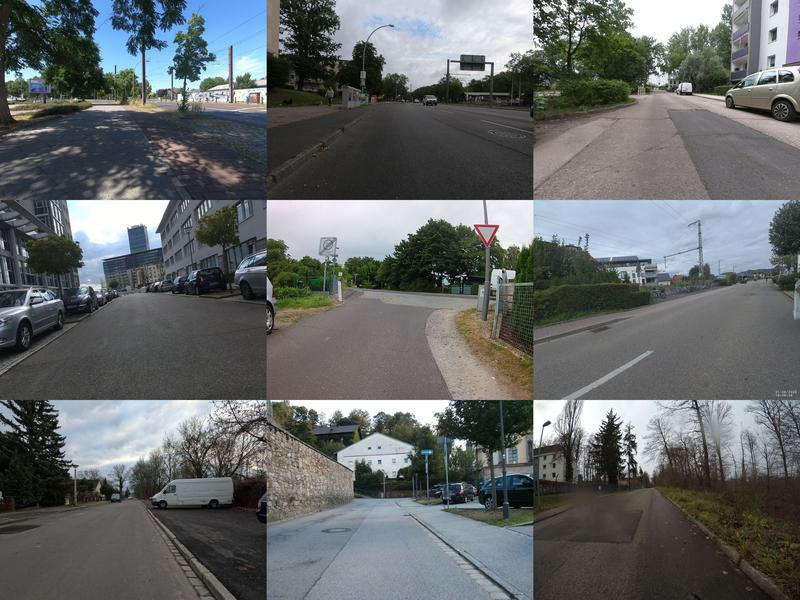
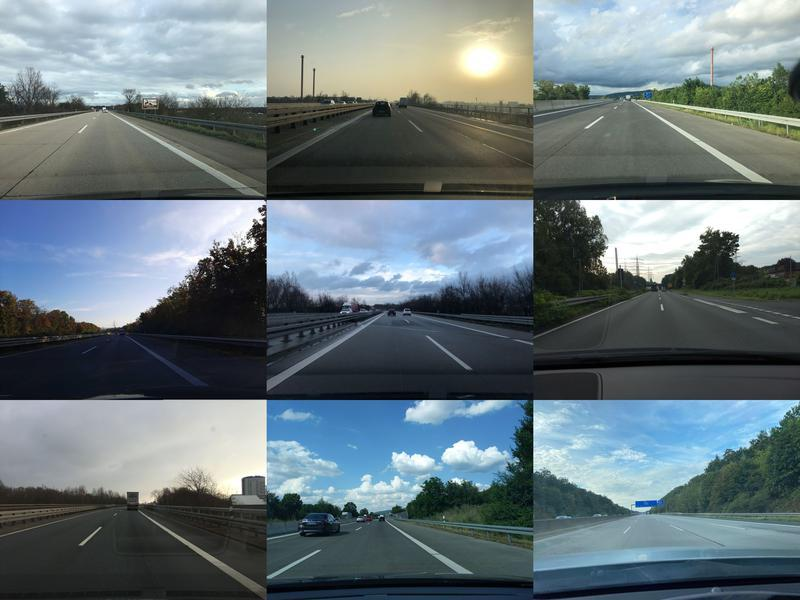
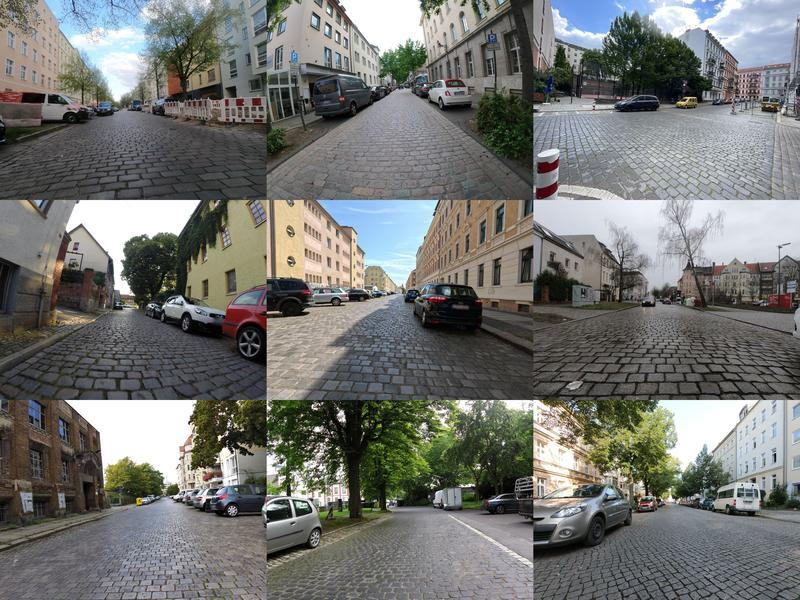
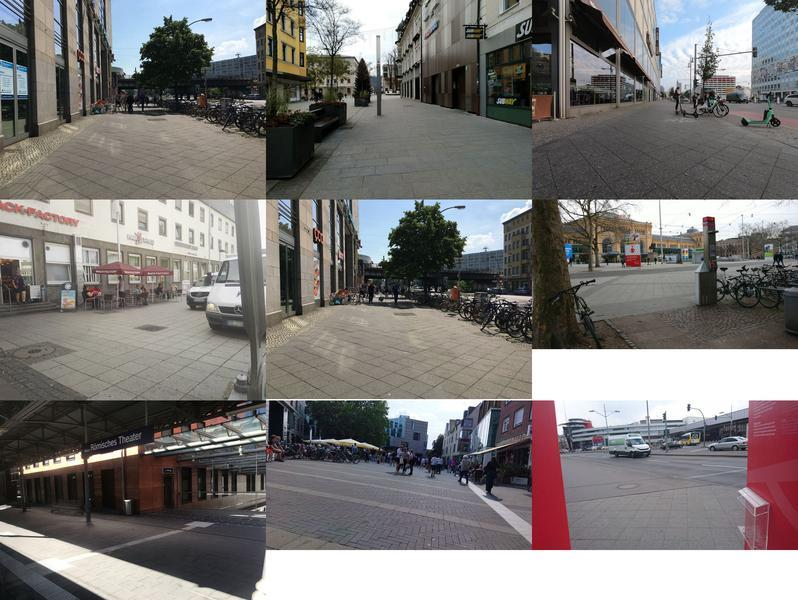
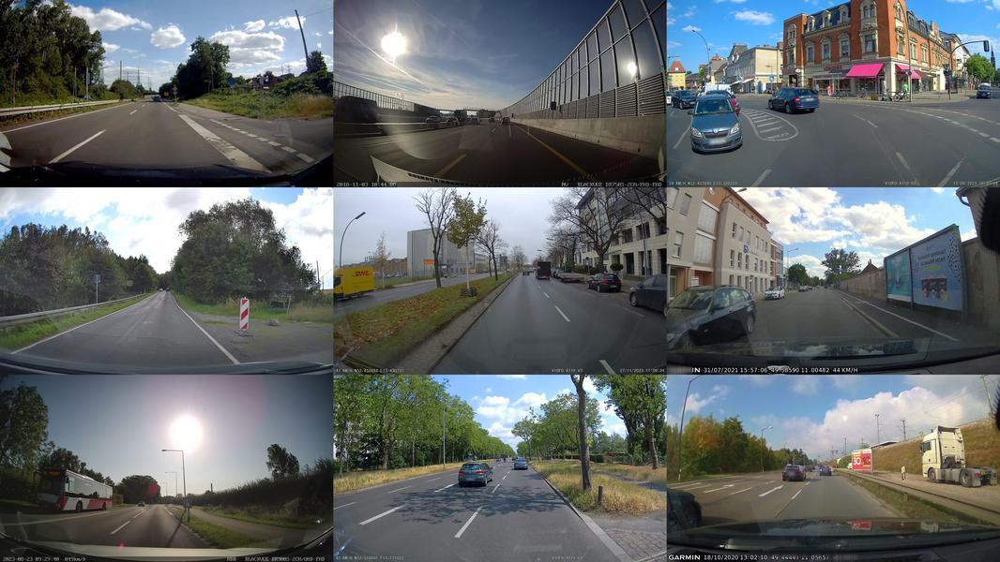
...
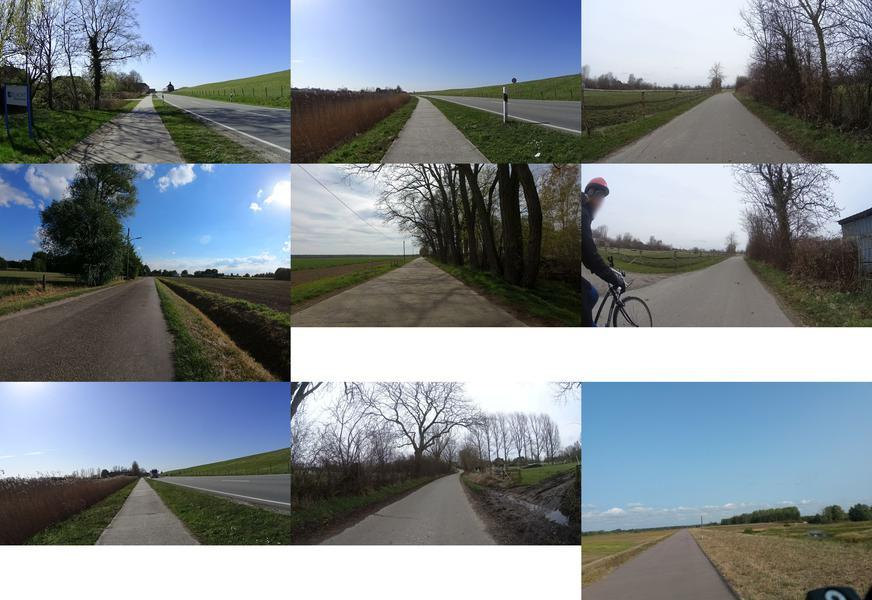
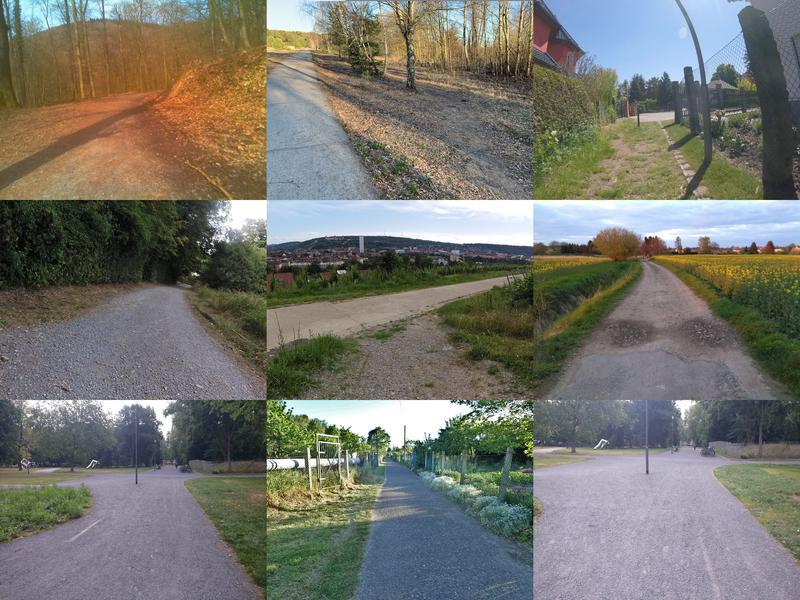
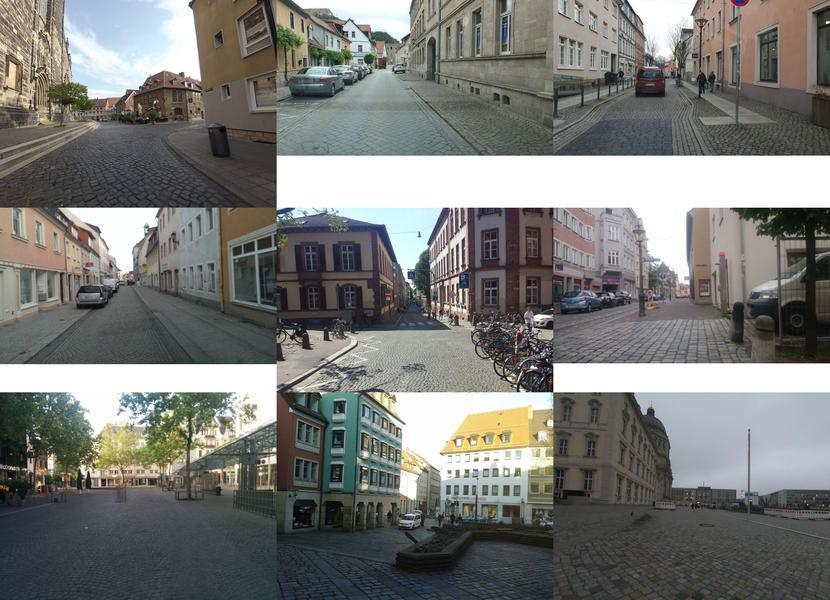
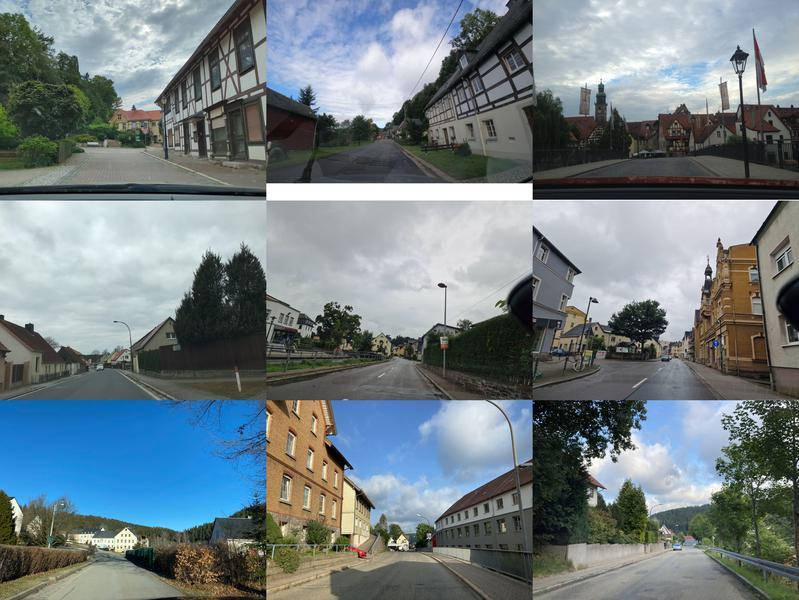
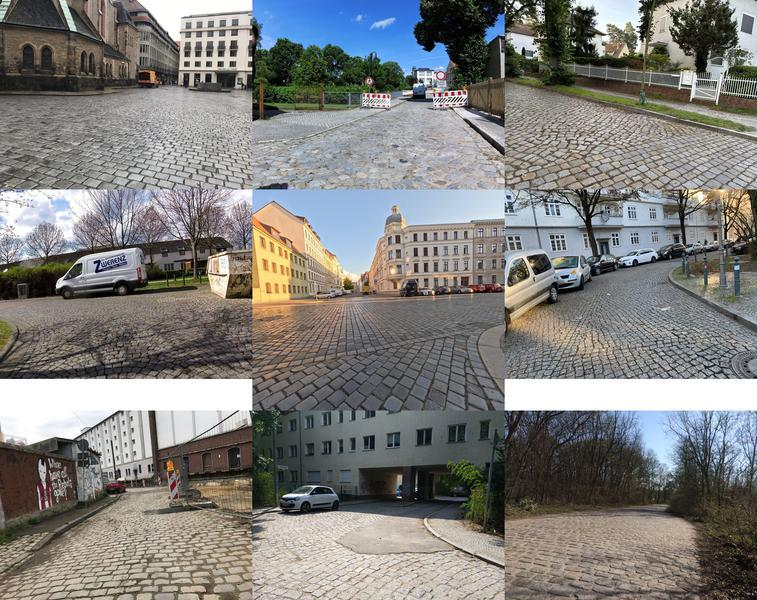

In [22]:
df = loaded_topic_model.get_topic_info().drop("Representative_Docs", axis=1).drop("Name", axis=1)

# Visualize the images
HTML(df.to_html(formatters={'Visual_Aspect': image_formatter}, escape=False))

In [24]:
# IMPORTANT: images must be the same and in same order as model is trained with
# info = loaded_topic_model.get_document_info(images)

# load info saved during taining
model_csv = model_name + '.csv'
csv_path = os.path.join(model_root, model_csv)
info = pd.read_csv(csv_path)
info.head(20)

,Document,Topic,Name,Representation,Visual_Aspect,Representative_Docs,Top_n_words,Probability,Representative_document
0,/home/surfaceai_data/data/training/V11/annotat...,-1,-1_says_stop_sign_that,"['says', 'stop', 'sign', 'that', 'city', 'whit...",<PIL.Image.Image image mode=RGB size=800x600 a...,"['a street with a street sign on it ', 'a stre...",says - stop - sign - that - city - white - str...,0.000000,False
1,/home/surfaceai_data/data/training/V11/annotat...,111,111_window_front_large_building,"['window', 'front', 'large', 'building', 'cloc...",<PIL.Image.Image image mode=RGB size=799x600 a...,['a large building with a clock on the front o...,window - front - large - building - clock - in...,1.000000,False
2,/home/surfaceai_data/data/training/V11/annotat...,69,69_leads_trail_village_area,"['leads', 'trail', 'village', 'area', 'wooded'...",<PIL.Image.Image image mode=RGB size=800x600 a...,"['a trail of trees leads to a small village ',...",leads - trail - village - area - wooded - fore...,1.000000,False
3,/home/surfaceai_data/data/training/V11/annotat...,100,100_light_sign_street_traffic,"['light', 'sign', 'street', 'traffic', 'it', '...",<PIL.Image.Image image mode=RGB size=800x600 a...,"['a street with a street sign on it ', 'a stre...",light - sign - street - traffic - it - cars - ...,1.000000,False
4,/home/surfaceai_data/data/training/V11/annotat...,-1,-1_says_stop_sign_that,"['says', 'stop', 'sign', 'that', 'city', 'whit...",<PIL.Image.Image image mode=RGB size=800x600 a...,"['a street with a street sign on it ', 'a stre...",says - stop - sign - that - city - white - str...,0.000000,False
5,/home/surfaceai_data/data/training/V11/annotat...,-1,-1_says_stop_sign_that,"['says', 'stop', 'sign', 'that', 'city', 'whit...",<PIL.Image.Image image mode=RGB size=800x600 a...,"['a street with a street sign on it ', 'a stre...",says - stop - sign - that - city - white - str...,0.000000,False
6,/home/surfaceai_data/data/training/V11/annotat...,17,17_bag_suitcase_black_luggage,"['bag', 'suitcase', 'black', 'luggage', 'metal...",<PIL.Image.Image image mode=RGB size=800x600 a...,['a train traveling down a track near a fence ...,bag - suitcase - black - luggage - metal - tra...,0.273271,False
7,/home/surfaceai_data/data/training/V11/annotat...,34,34_bench_sits_fence_wooden,"['bench', 'sits', 'fence', 'wooden', 'tree', '...",<PIL.Image.Image image mode=RGB size=800x600 a...,['a wooden bench in a grassy area next to a fe...,bench - sits - fence - wooden - tree - house -...,0.836248,False
8,/home/surfaceai_data/data/training/V11/annotat...,15,15_going_sitting_over_tree,"['going', 'sitting', 'over', 'tree', 'leads', ...",<PIL.Image.Image image mode=RGB size=800x600 a...,"['a trail of trees leads to a forest ', 'a par...",going - sitting - over - tree - leads - bridge...,0.797977,False
9,/home/surfaceai_data/data/training/V11/annotat...,-1,-1_says_stop_sign_that,"['says', 'stop', 'sign', 'that', 'city', 'whit...",<PIL.Image.Image image mode=RGB size=800x600 a...,"['a street with a street sign on it ', 'a stre...",says - stop - sign - that - city - white - str...,0.000000,False


,Document,Probability,ID
398,,1.000000,173003994628441
670,,1.000000,353048146239560
779,,1.000000,488332795749294
2682,,1.000000,1525120291025491
1061,,1.000000,281688633597010
2601,,1.000000,1128195190991999
1613,,1.000000,330161311805261
2552,,1.000000,1366664490507089
1930,,1.000000,187129856606856
2528,,1.000000,1226425001093665

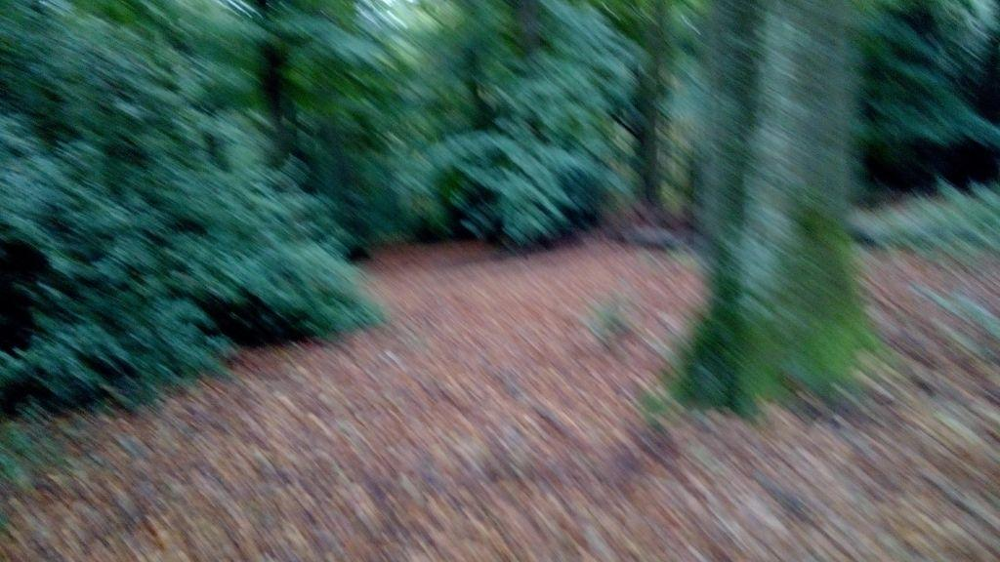
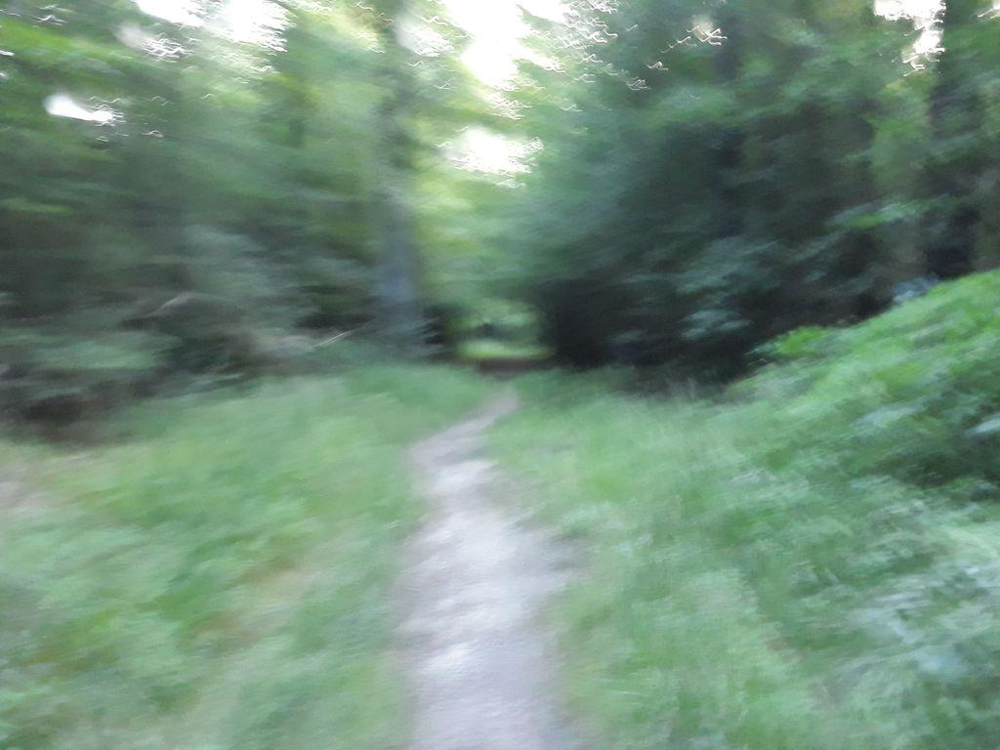
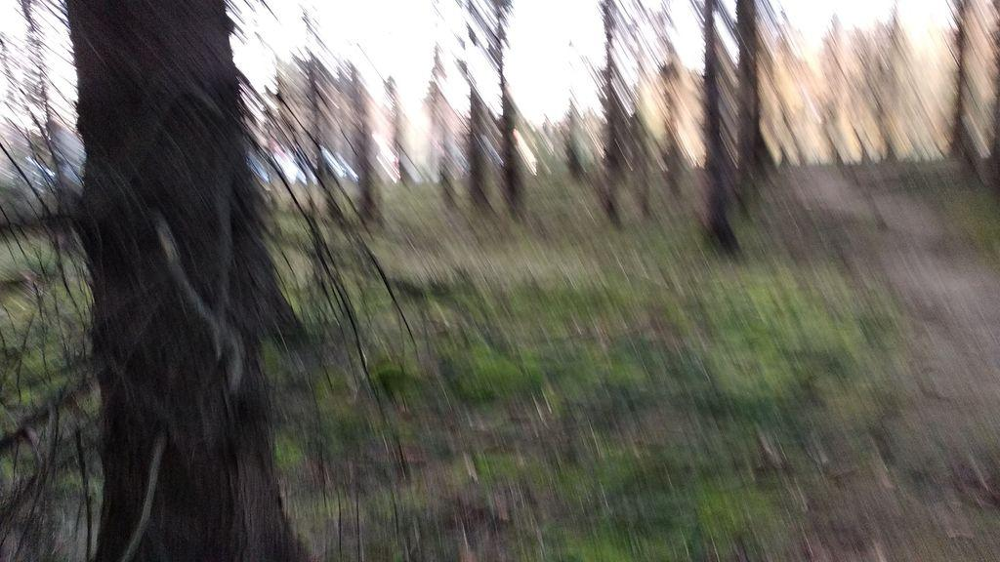
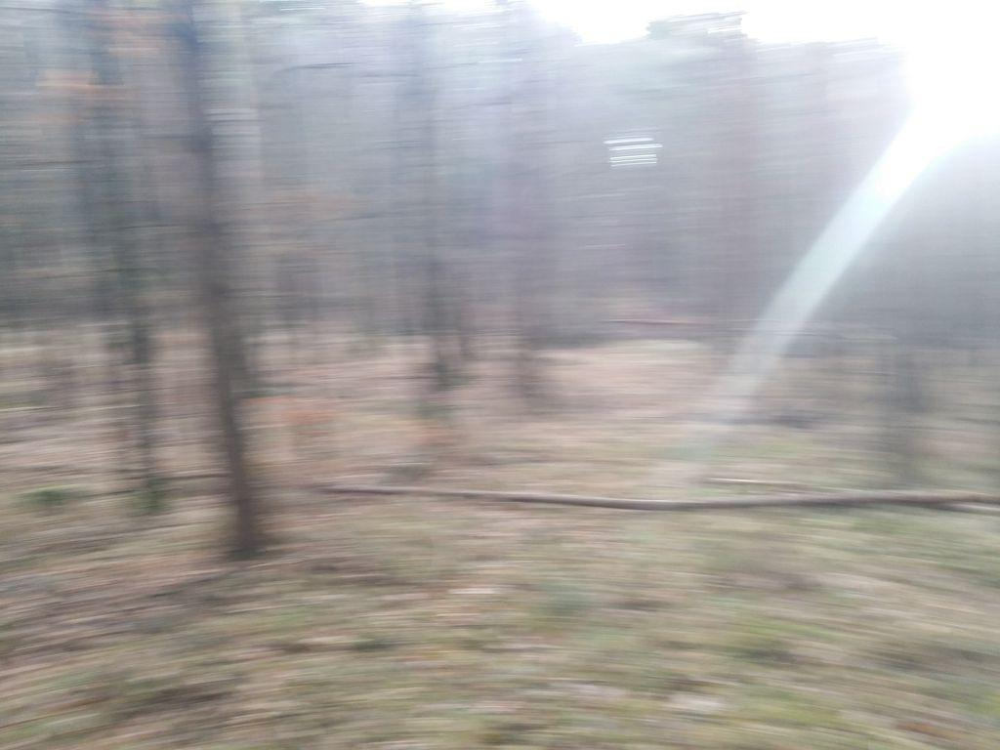
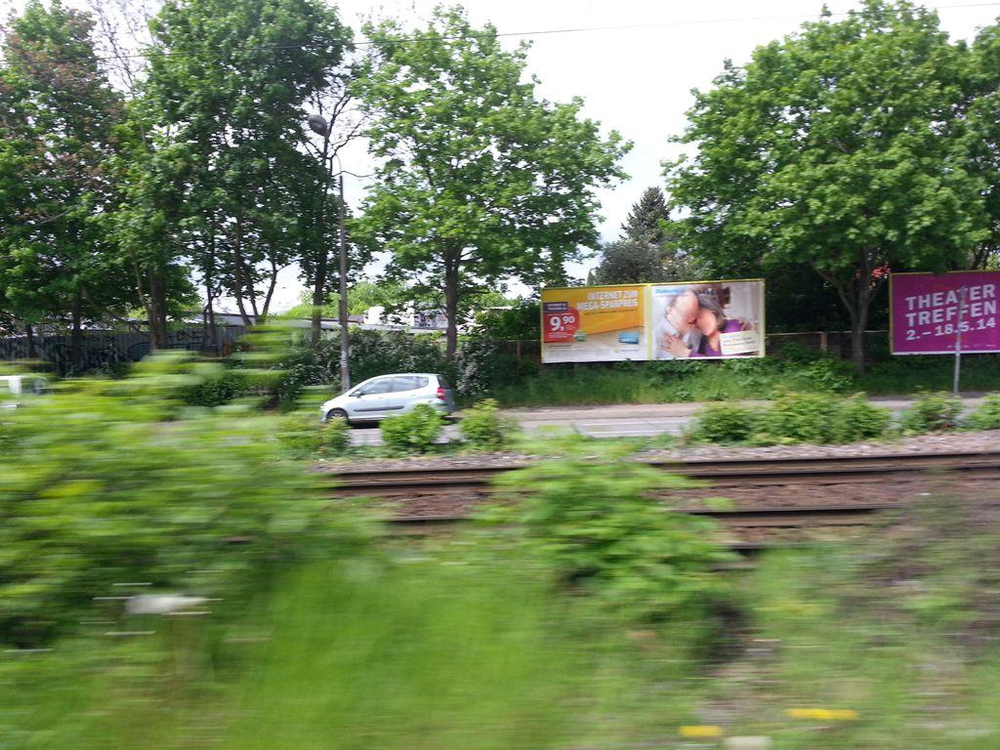
...
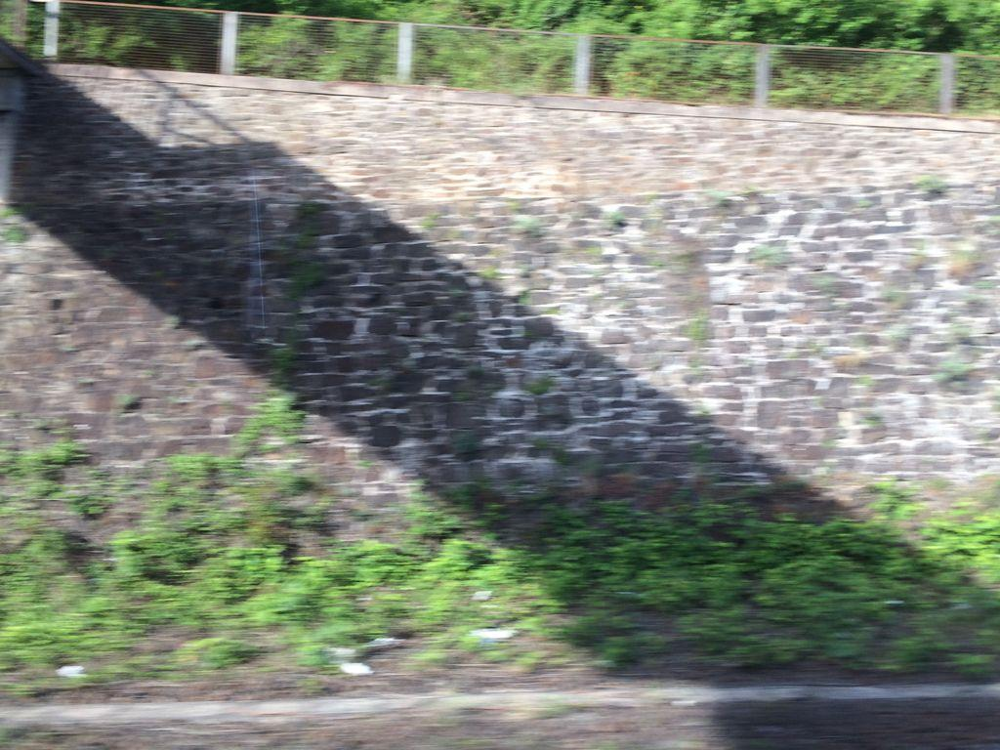
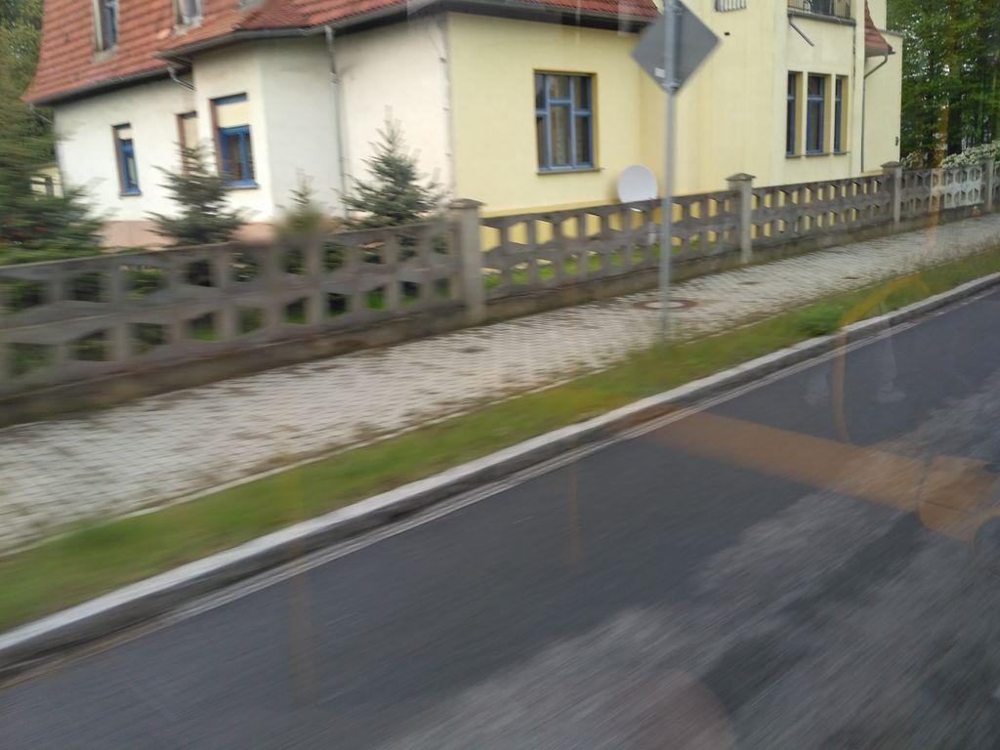
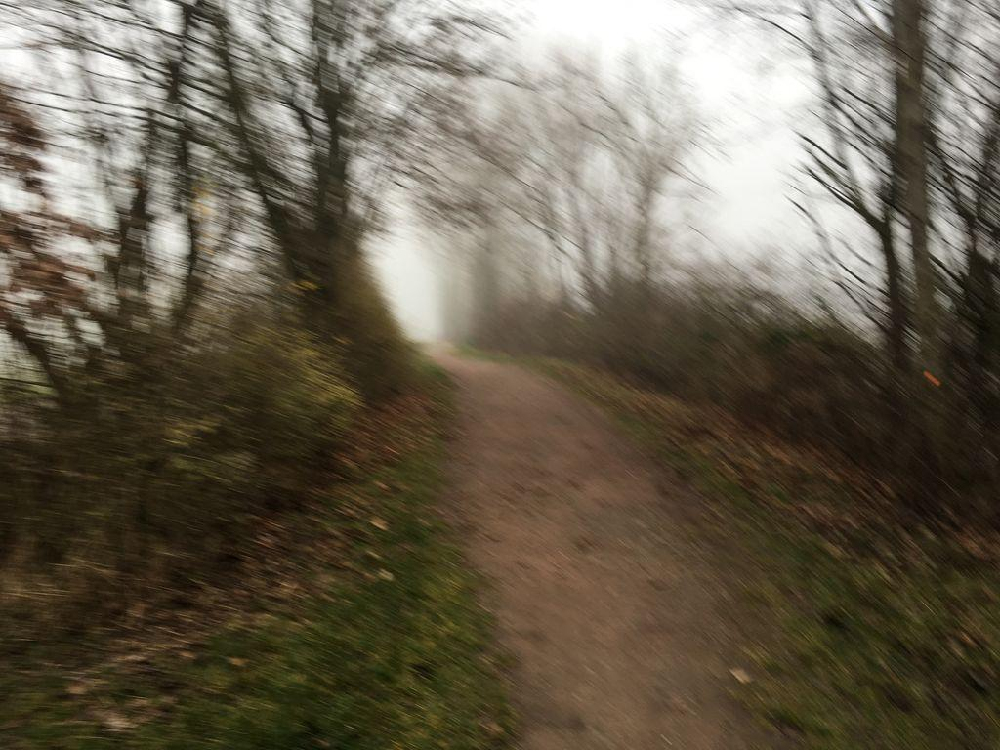
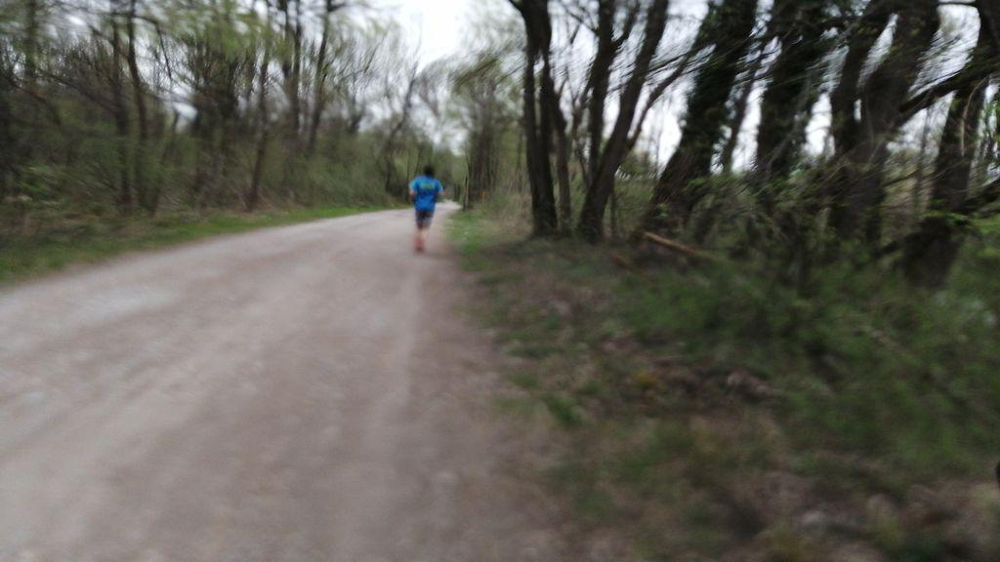
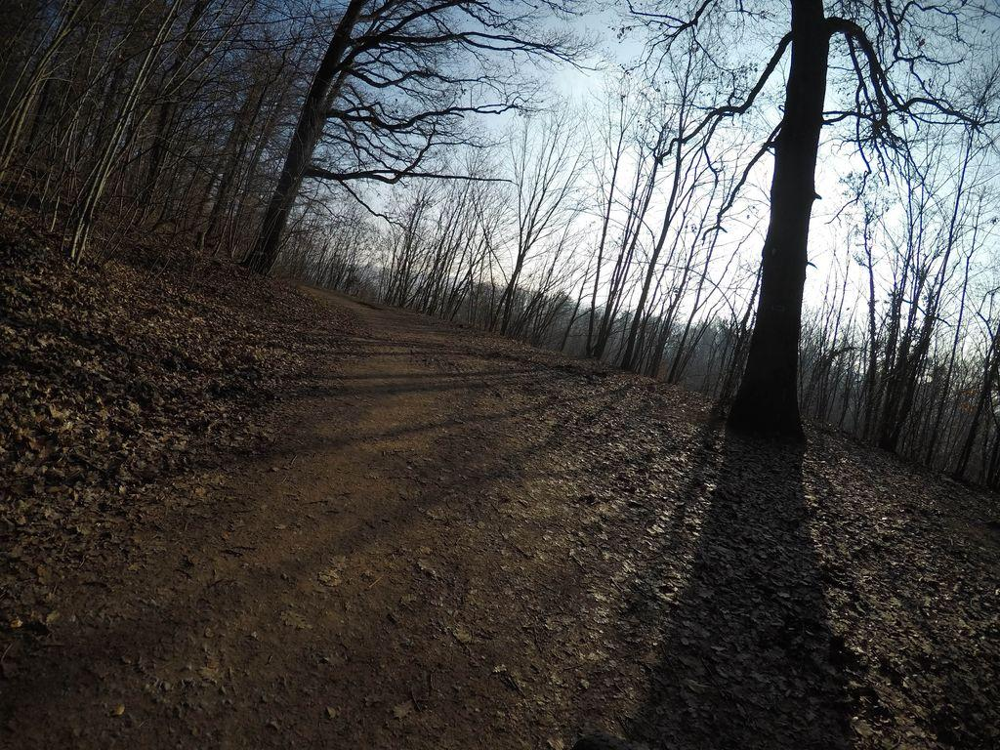

In [28]:
topic = 53

idx = 4

sorted_info = info[info['Topic']==topic][['Document', 'Probability']].sort_values(by='Probability', ascending=False)
# repr = pd.DataFrame([sorted_info.iloc[idx]])

# HTML(repr.to_html(formatters={'Document': image_formatter_new_path}, escape=False))
for i, row in sorted_info[['Document']].iterrows():
    sorted_info.loc[i, 'ID'] = os.path.splitext(os.path.split(row['Document'])[-1])[0]

images_path = os.path.join(root_data, 'V12/annotated')

images = []
ids = []
for root, _, fnames in sorted(os.walk(images_path, followlinks=True)):
    for fname in sorted(fnames):
        path = os.path.join(root, fname)
        if fname.endswith((".jpg", ".jpeg", ".png")):
            images.append(path)
            ids.append(os.path.splitext(os.path.split(path)[-1])[0])

images_path = os.path.join(root_data, 'V12/annotated')

def image_formatter_new_path(im):
    id = os.path.splitext(os.path.split(im)[-1])[0]
    idx = ids.index(id)
    # print(idx)
    img = Image.open(images[idx])
    return f'<img src="data:image/jpeg;base64,{image_base64(img)}">'

# Visualize the images
HTML(sorted_info.to_html(formatters={'Document': image_formatter_new_path}, escape=False))
    

In [26]:
idx = info.groupby('Topic')['Probability'].idxmax()

In [39]:
most_repr = info.loc[idx, ['Topic', 'Document', 'Probability']]

In [40]:
for _, row in most_repr.iterrows():
    topic = row['Topic']
    id = os.path.splitext(os.path.split(row['Document'])[-1])[0]
    print(f'{topic}: {id}')

-1: 1175113039579141
0: 292276845787849
1: 1396195420849997
2: 816262545982653
3: 1165154770939283
4: 1108901116248517
5: 214233026922671
6: 154947183236648
7: 152434446772289
8: 1094000727757509
9: 1106452096555277
10: 320936613200297
11: 774534637557752
12: 1508829195992597
13: 187285166587562
14: 575892096706336
15: 1051112468958729
16: 129743449569474
17: 246121055150153
18: 1178313585927604
19: 196310018979669
20: 1004846316926785
21: 1495436407665593
22: 160696209318495
23: 197601893199029
24: 196051056834852
25: 1504687363196750
26: 1526020488216070
27: 264265018729502
28: 1163710804192536


In [45]:
images_path = os.path.join(root_data, 'V12/annotated')

images = []
ids = []
for root, _, fnames in sorted(os.walk(images_path, followlinks=True)):
    for fname in sorted(fnames):
        path = os.path.join(root, fname)
        if fname.endswith((".jpg", ".jpeg", ".png")):
            images.append(path)
            ids.append(os.path.splitext(os.path.split(path)[-1])[0])

In [46]:
ids

['1108901116248517',
 '1132150697721186',
 '1156688858072710',
 '1165154770939283',
 '1175113039579141',
 '1178313585927604',
 '1198561677264617',
 '1222472534874486',
 '1235858586847697',
 '129525449781518',
 '1299005513849605',
 '1341835419633858',
 '1349900185630750',
 '1370248326665078',
 '1382963682081381',
 '1391166841241877',
 '1391242591245225',
 '1396195420849997',
 '1398786817146286',
 '142517154445344',
 '142741024529512',
 '144246817728733',
 '149890910430455',
 '150839037637071',
 '159824202734319',
 '163865108896626',
 '1641150989429094',
 '169832331809758',
 '175250447804351',
 '1803618686722769',
 '1829362023906325',
 '183495953667818',
 '1835147883325694',
 '189403176653142',
 '215815280351715',
 '220559779840852',
 '230638958835919',
 '234573121775630',
 '241120797792524',
 '2593833144096186',
 '267694342484064',
 '277338690696898',
 '285586273519913',
 '2856316874607739',
 '292504775755050',
 '293245499014573',
 '2941532699417628',
 '2942068519364718',
 '294564448839

4
450
17
108
3
0
1293
259
253
2923
150
57
2062
3164
322
86
135
3459
394
5
339
2916
247
1158
3798
338
3752
3165
409
972


,Topic,Document,Probability
4,-1,,0.0
450,0,,1.0
17,1,,1.0
108,2,,1.0
3,3,,1.0
0,4,,1.0
1293,5,,1.0
259,6,,1.0
253,7,,1.0
2922,8,,1.0

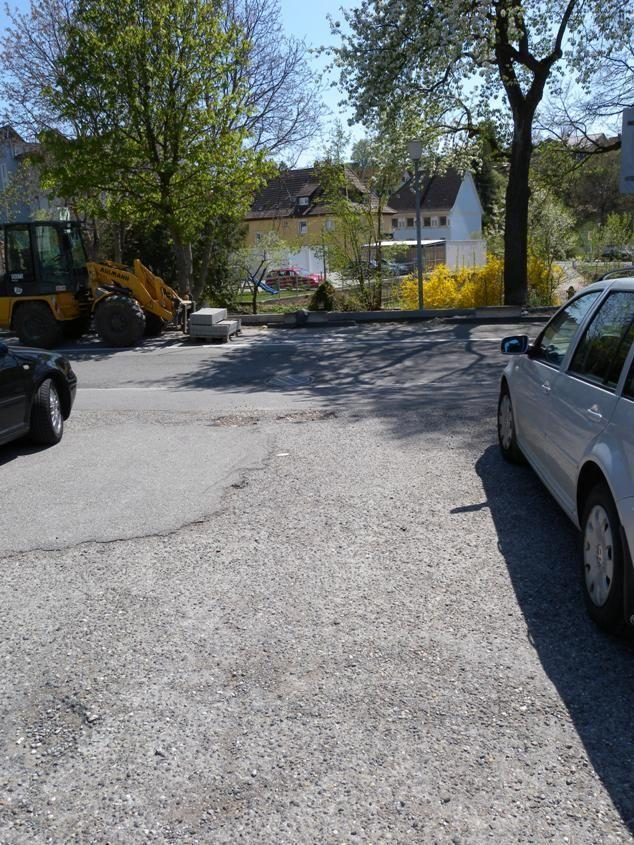
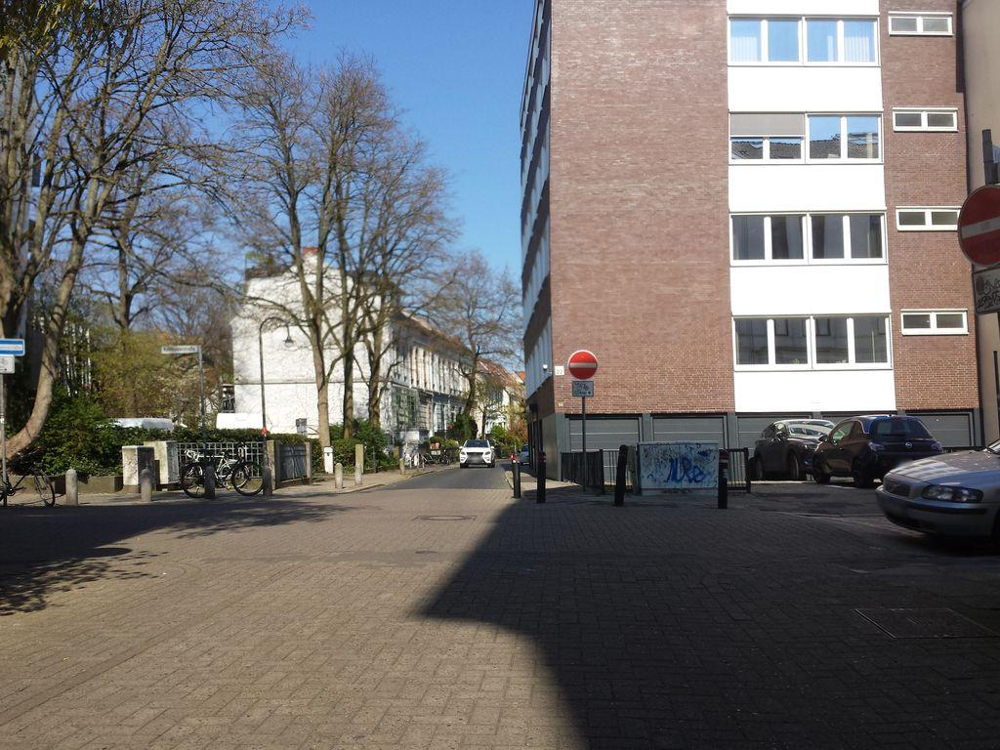
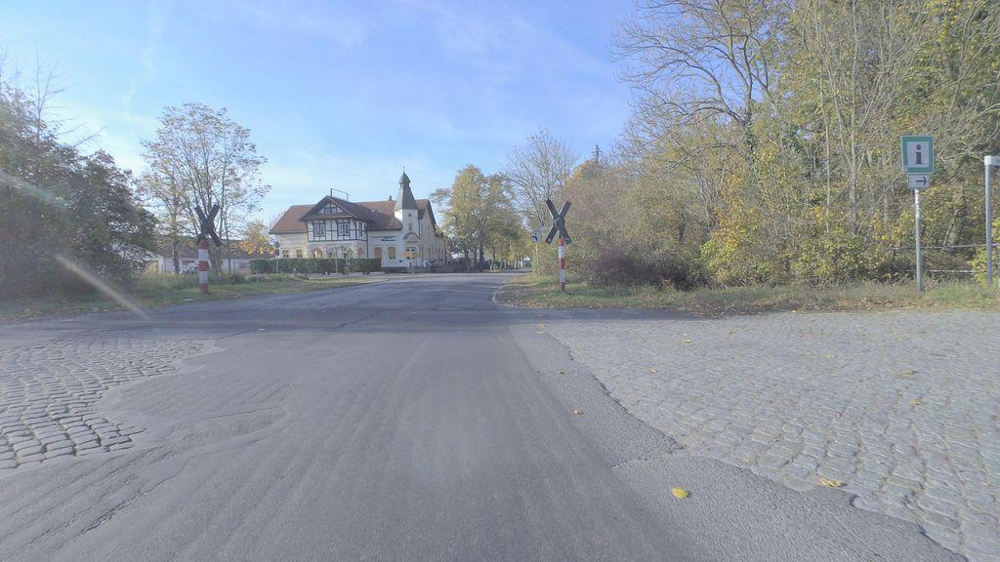
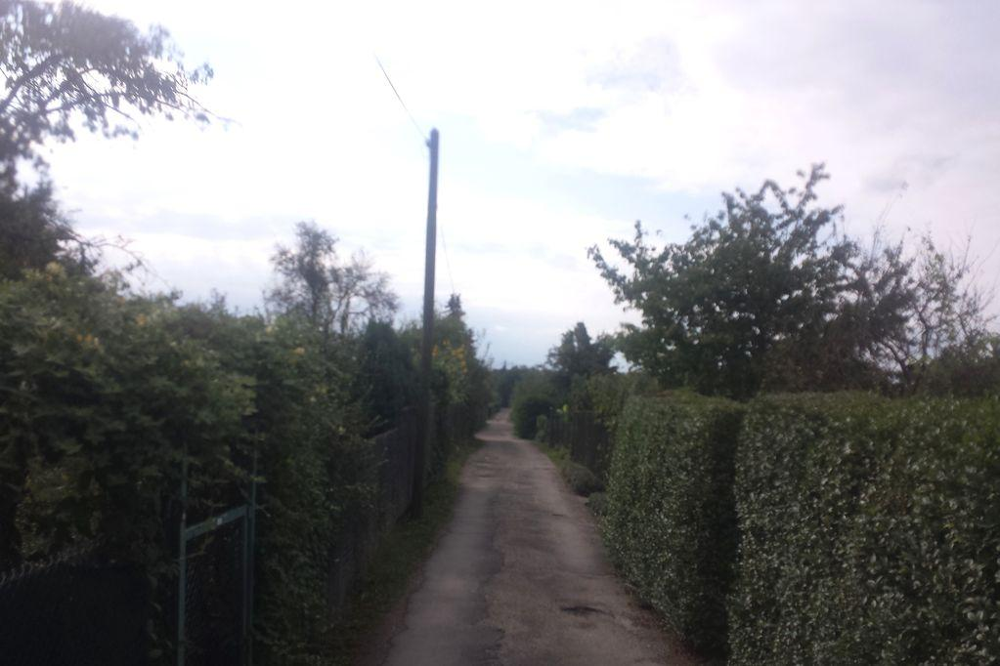
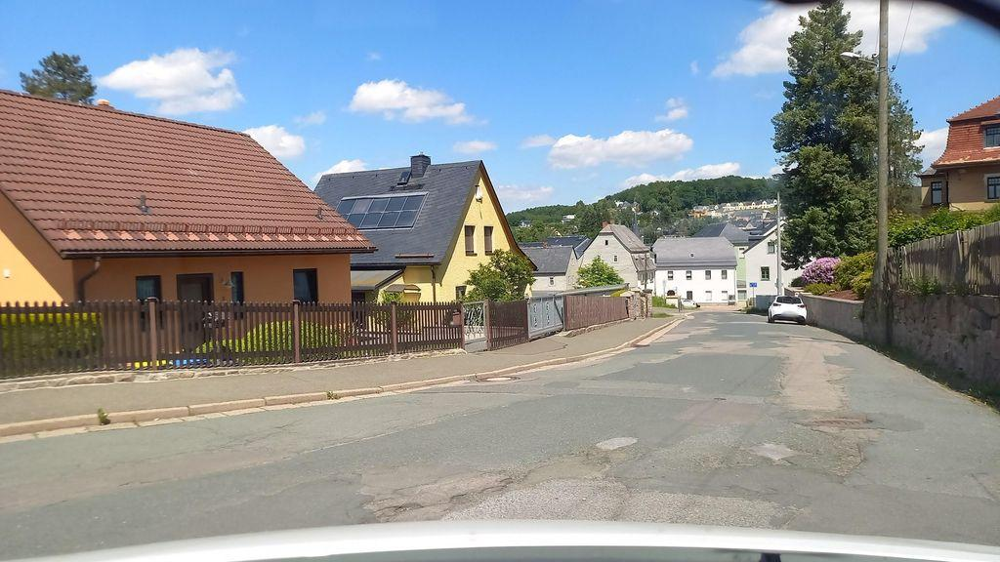
...
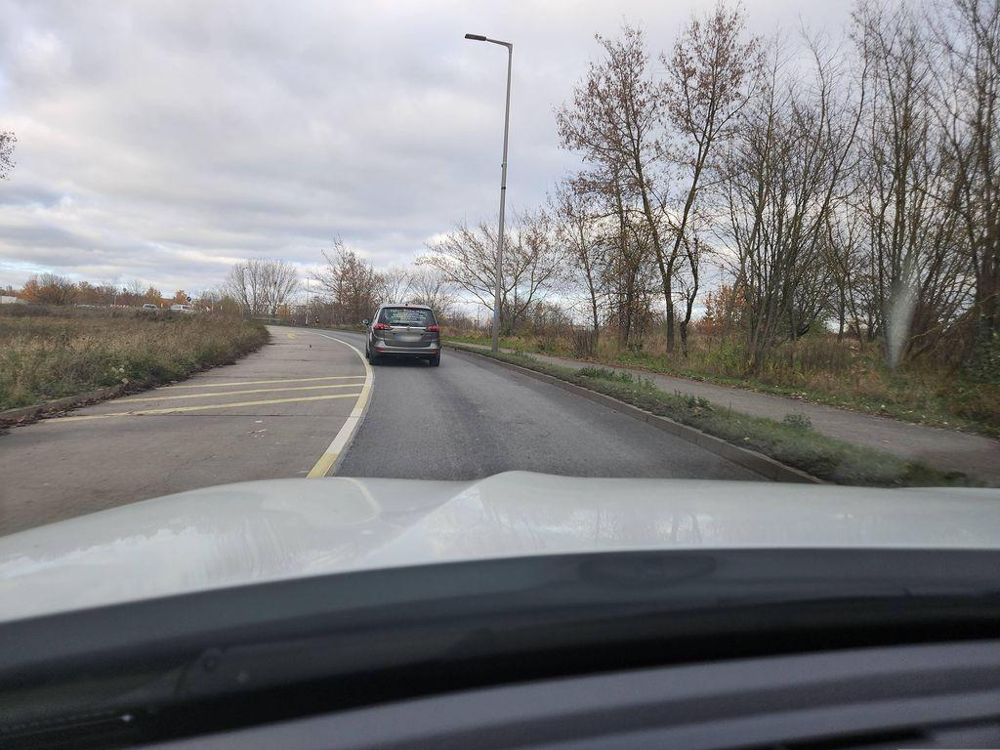
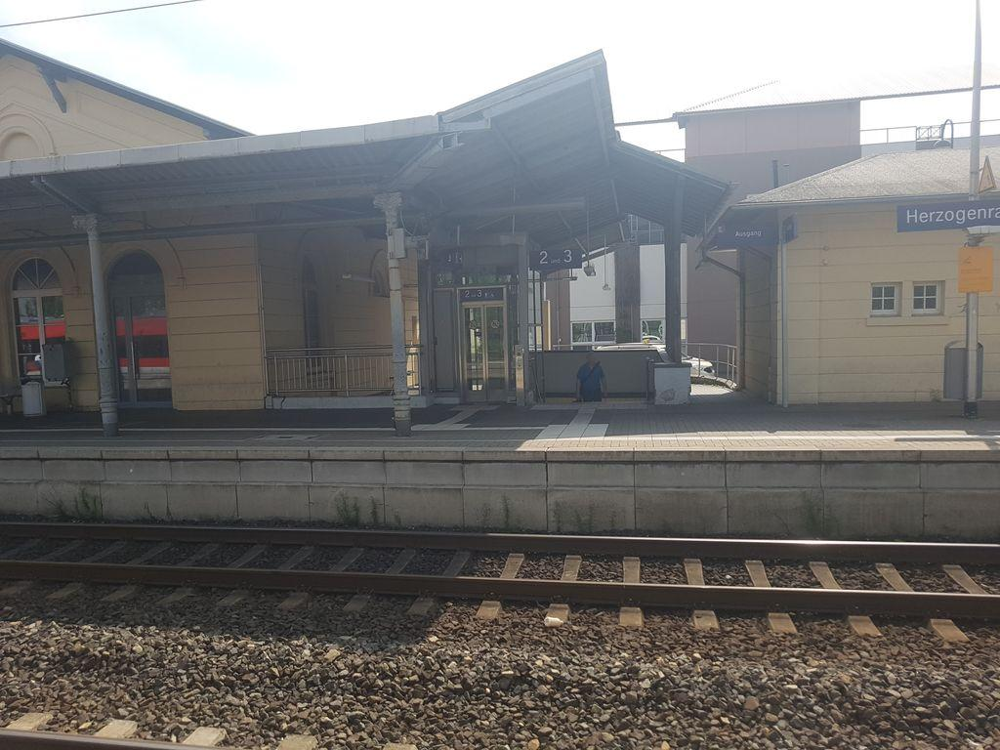
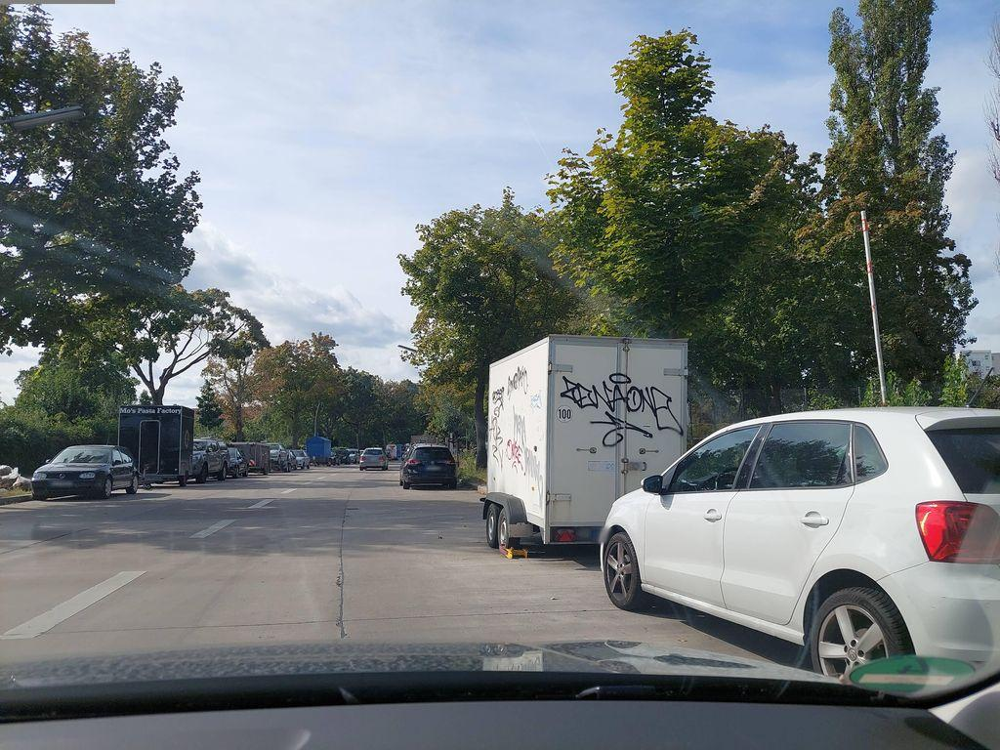
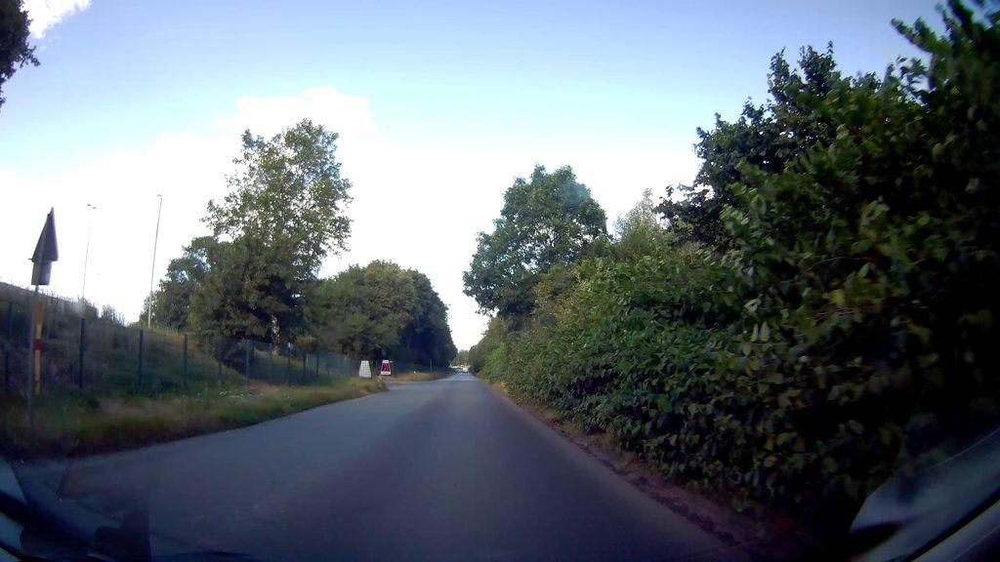
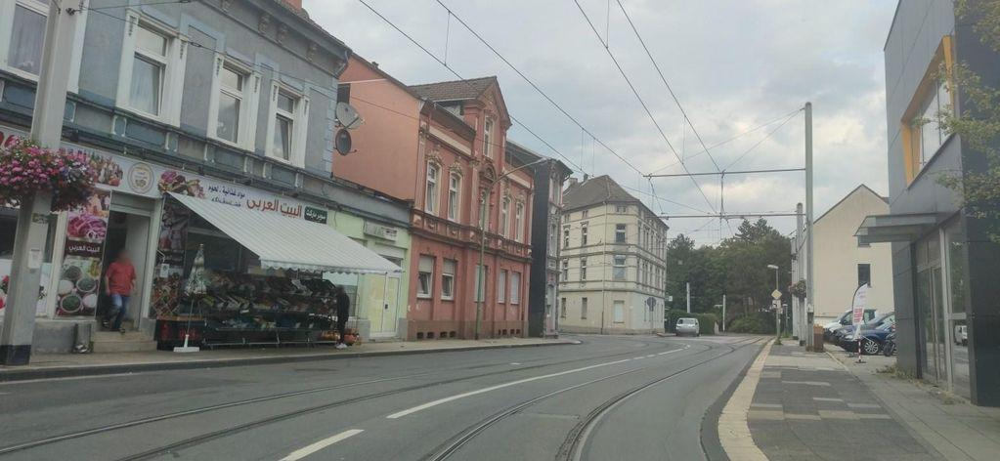

In [49]:
def image_formatter_new_path(im):
    id = os.path.splitext(os.path.split(im)[-1])[0]
    idx = ids.index(id)
    print(idx)
    img = Image.open(images[idx])
    return f'<img src="data:image/jpeg;base64,{image_base64(img)}">'

# Visualize the images
HTML(most_repr.to_html(formatters={'Document': image_formatter_new_path}, escape=False))

In [70]:
loaded_topic_model.visualize_hierarchy()

In [53]:
images_path = os.path.join(root_data, 'V9/annotated/asphalt/bad')
images_new = []
for root, _, fnames in sorted(os.walk(images_path, followlinks=True)):
    for fname in sorted(fnames):
        path = os.path.join(root, fname)
        if fname.endswith((".jpg", ".jpeg", ".png")):
            images_new.append(path)



In [15]:
embeddings_path = os.path.join(root_embeddings, "effnet_feature_embeddings.pkl")
with open(os.path.join(embeddings_path), "rb") as f_in:
    data = pickle.load(f_in)
    images = data['images']
    embeddings = data['embeddings'].cpu().numpy()

In [17]:
print(embeddings_path)

/Users/edith/git/SurfaceAI/classification_models/notebooks/../embeddings/effnet_feature_embeddings.pkl


In [19]:
print(embeddings)

[[-0.14500925 -0.04922337 -0.16118214 ... -0.10117828 -0.10505392
  -0.07817686]
 [-0.13653567  0.3916119   0.16763188 ... -0.13613153 -0.01038118
   0.5067318 ]
 [-0.14430462  0.3876772  -0.15441757 ... -0.1408812  -0.11031589
   0.5728427 ]
 ...
 [-0.08203247 -0.08738945  0.2599912  ... -0.1163093  -0.03014533
  -0.05079576]
 [-0.17839687 -0.19436672 -0.01774104 ... -0.1568187  -0.14015114
   0.41971913]
 [-0.16571142 -0.16656883 -0.15491554 ... -0.0814468  -0.11068226
  -0.13443808]]


In [20]:
embeddings.shape

(9980, 1280)

In [21]:
len(images)

9980

In [16]:
new_label, new_pred = loaded_topic_model.transform(documents=None, images=images, embeddings=embeddings)
# error: bertopic code error for documents = None!

TypeError: object of type 'NoneType' has no len()

In [55]:
new_label, new_pred

(array([ 1, 81, 84, 29, 49, 74, 69, 23, 61,  1,  7, 45,  1, 79, 23, 31, 64,
        50, 10, 81, 23, 86,  1, 59, 64, 14,  7, 79,  1, 21, 10, 44, 69,  7,
        31,  6, 58, 60, 53, 74,  7, 23, 44, 64, 14, 50, 81, 84, 46, 52, 31,
         1, 64,  7,  8,  1, 53, 45,  7, 61, 32, 45, 53, 69, 85,  7, -1, 22,
        37, 23,  8, 74, 59, 82, 23, 25, 69,  7,  0, 23,  8,  7, -1, 69, 23,
        58, 44, 25, 16, 27, 82, 49, 84, 49,  7, 41, 19, 32, 64, 45,  3, 10,
         1, 46, 22, 90, 25, 84, 53, 41, 46, 49, 23]),
 array([0.88143164, 0.89904298, 0.83515427, 0.85214771, 0.84258414,
        0.89464725, 0.87169491, 0.93039356, 0.9253203 , 0.89341569,
        0.91377169, 0.92796896, 0.92910744, 0.8991306 , 0.85812244,
        0.89335483, 0.7633959 , 0.85844707, 0.92131974, 0.88396347,
        0.89002106, 0.81380193, 0.87361742, 0.87180218, 0.87854144,
        0.86352001, 0.91704838, 0.87258046, 0.84318212, 0.90524132,
        0.91514179, 0.90067843, 0.89380495, 0.91374739, 0.86252158,
        0.9611

In [74]:
idx = 18
Image.open(images_new[idx]).show()
topic_id = new_label[idx]
print(topic_id)
loaded_topic_model.get_topic_info()["Visual_Aspect"][topic_id+1].show()
info['Id'] = [os.path.splitext(os.path.split(p)[-1])[0] for p in info["Document"]]
info[info["Id"]==os.path.splitext(os.path.split(images_new[idx])[-1])[0]]["Topic"]

10


18    10
Name: Topic, dtype: int64